In [1]:
import pandas as pd

from classification_evaluator import ClassificationEvaluator
from multi_classification_evaluator import MultiClassificationEvaluator

from IPython.display import Markdown, display
import warnings

warnings.filterwarnings("ignore")

## GitHub Stargazers - SNAP: Network dataset (binary classification)

In [2]:
gs_results = pd.read_csv("../datasets/github_stargazers/results2.csv")

In [3]:
gs_evaluator = ClassificationEvaluator(predictions=gs_results)
gs_eval_df = gs_evaluator.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)
display(Markdown("All results"), gs_eval_df)

# find top specification for each method
tmp = gs_eval_df.merge(
    gs_eval_df["method"]
    .str.rsplit("_", 1, expand=True)
    .rename(columns={0: "method_name", 1: "params"}),
    left_index=True,
    right_index=True,
)
idx = tmp.groupby(["method_name"])["AUC"].transform(max) == tmp["AUC"]
best = tmp.loc[idx][gs_eval_df.columns]

display(Markdown("Top methods: "), list(best["method"]))

All results

,method,accuracy,f1,precision,recall,AUC
0,pagerank_w_mean_0.00,0.547662,0.649024,0.554837,0.781727,0.552992
1,pagerank_w_mean_0.25,0.564165,0.649475,0.570002,0.754700,0.576954
2,pagerank_w_mean_0.50,0.591749,0.638709,0.606525,0.674501,0.613412
3,pagerank_w_mean_0.75,0.599057,0.641260,0.615053,0.669800,0.625416
4,pagerank_w_mean_1.00,0.600157,0.644444,0.614636,0.677291,0.623977
5,pagerank_concat,0.577760,0.570675,0.625723,0.524530,0.611067
6,pagerank_p_proj_True,0.577446,0.562383,0.630590,0.507491,0.626599
7,pagerank_p_proj_False,0.571788,0.557028,0.623703,0.503231,0.622162
8,pagerank_w_proj_0.00,0.571552,0.618688,0.590521,0.649677,0.590283
9,pagerank_w_proj_0.25,0.572574,0.573311,0.615255,0.536722,0.619704


Top methods: 

['pagerank_w_mean_0.75',
 'pagerank_concat',
 'pagerank_p_proj_True',
 'pagerank_w_proj_1.00',
 'closeness_centrality_w_mean_0.75',
 'closeness_centrality_concat',
 'closeness_centrality_p_proj_True',
 'closeness_centrality_w_proj_0.75',
 'current_flow_closeness_centrality_w_mean_0.75',
 'current_flow_closeness_centrality_concat',
 'current_flow_closeness_centrality_p_proj_True',
 'current_flow_closeness_centrality_w_proj_0.50']

In [4]:
# initialize the 2nd. evaluator to plot results for top methods only
gs_results_best = gs_results.loc[gs_results["method"].isin(best["method"])]
gs_results_best["method"] = gs_results_best["method"].str.rsplit("_", 1, expand=True)[0]

gs_evaluator_best = ClassificationEvaluator(predictions=gs_results_best)

In [5]:
gs_evaluator_best.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)

,method,accuracy,f1,precision,recall,AUC
0,pagerank_w_mean,0.599057,0.641260,0.615053,0.669800,0.625416
1,pagerank,0.577760,0.570675,0.625723,0.524530,0.611067
2,pagerank_p_proj,0.577446,0.562383,0.630590,0.507491,0.626599
3,pagerank_w_proj,0.588527,0.593226,0.629617,0.560811,0.628138
4,closeness_centrality_w_mean,0.602908,0.641809,0.620222,0.664953,0.625109
5,closeness_centrality,0.578153,0.573155,0.624827,0.529377,0.616101
6,closeness_centrality_p_proj,0.577053,0.562297,0.629920,0.507785,0.627681
7,closeness_centrality_w_proj,0.585462,0.579849,0.633374,0.534665,0.628375
8,current_flow_closeness_centrality_w_mean,0.604008,0.647450,0.618170,0.679642,0.628182
9,current_flow_closeness_centrality,0.575246,0.566664,0.623831,0.519095,0.614179


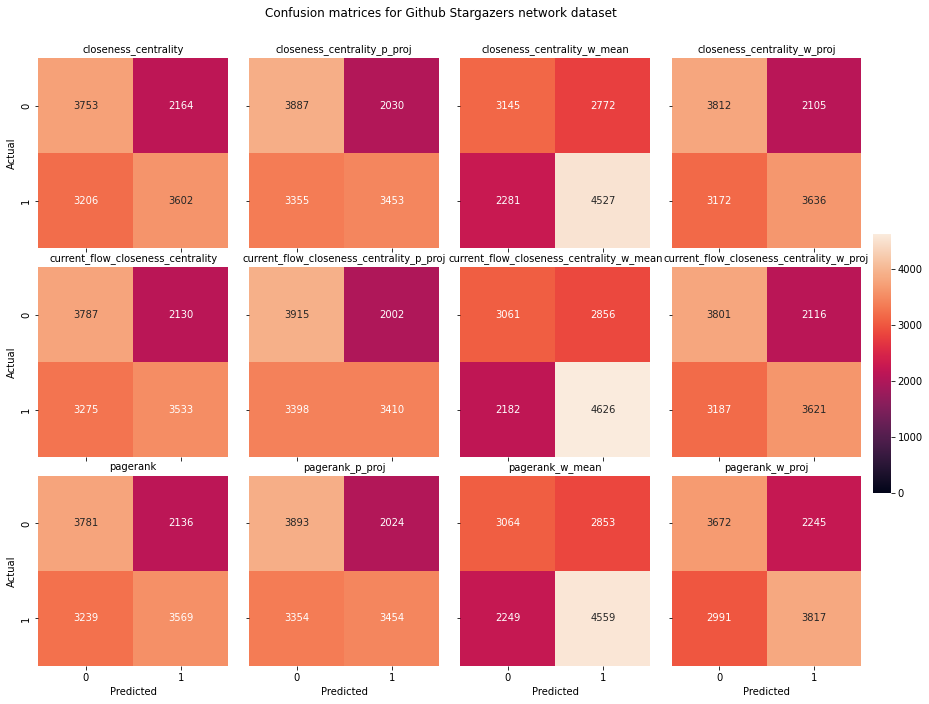

In [6]:
gs_evaluator_best.plot_confusion_matrices_grid(
    plot_title="Confusion matrices for Github Stargazers network dataset",
    cols_number_on_plot=4,
)

In [7]:
gs_evaluator_best.plot_roc_curves(
    plot_title="ROC curves for Github Stargazers network dataset",
    width=1000,
    height=600,
)

In [8]:
gs_evaluator_best.plot_precision_recall(width=1000, height=700)

## Random Partition Graphs - synthetic dataset

In [9]:
rpg_results = pd.read_csv("../datasets/partition_graphs/results2.csv",index_col=0)

rpg_results["probability_prediction"] = (
    rpg_results[
        [
            "probability_prediction_0",
            "probability_prediction_1",
            "probability_prediction_2",
        ]
    ]
    .to_numpy()
    .tolist()
)

In [10]:
rpg_evaluator = MultiClassificationEvaluator(predictions=rpg_results)
rpg_eval_df = rpg_evaluator.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)
display(Markdown("All results"), rpg_eval_df)

# find top specification for each method
tmp = rpg_eval_df.merge(
    rpg_eval_df["method"]
    .str.rsplit("_", 1, expand=True)
    .rename(columns={0: "method_name", 1: "params"}),
    left_index=True,
    right_index=True,
)
idx = tmp.groupby(["method_name"])["macro_AUC"].transform(max) == tmp["macro_AUC"]
best = tmp.loc[idx][rpg_eval_df.columns]

display(Markdown("Top methods: "), list(best["method"]))

All results

,method,accuracy,macro_f1,macro_precision,macro_recall,macro_AUC
0,pagerank_w_mean_0.00,0.621111,0.427697,0.415848,0.453228,0.755018
1,pagerank_w_mean_0.25,0.570000,0.361154,0.401026,0.400741,0.727599
2,pagerank_w_mean_0.50,0.544444,0.343091,0.368148,0.382434,0.637304
3,pagerank_w_mean_0.75,0.538889,0.362467,0.352975,0.388466,0.581134
4,pagerank_w_mean_1.00,0.470000,0.331830,0.319492,0.358201,0.594824
5,pagerank_concat,0.617778,0.434944,0.411502,0.464550,0.737780
6,pagerank_p_proj_True,0.624444,0.433711,0.413480,0.459683,0.749646
7,pagerank_p_proj_False,0.518889,0.353073,0.336889,0.376825,0.572481
8,pagerank_w_proj_0.00,0.631111,0.436744,0.423515,0.462011,0.763286
9,pagerank_w_proj_0.25,0.607778,0.414138,0.407231,0.440529,0.716500


Top methods: 

['pagerank_w_mean_0.00',
 'pagerank_concat',
 'pagerank_p_proj_True',
 'pagerank_w_proj_0.00',
 'closeness_centrality_w_mean_0.00',
 'closeness_centrality_concat',
 'closeness_centrality_p_proj_True',
 'closeness_centrality_w_proj_0.25',
 'current_flow_closeness_centrality_w_mean_0.00',
 'current_flow_closeness_centrality_concat',
 'current_flow_closeness_centrality_p_proj_True',
 'current_flow_closeness_centrality_w_proj_0.00']

In [11]:
# initialize the 2nd. evaluator to plot results for top methods only
rpg_results_best = rpg_results.loc[rpg_results["method"].isin(best["method"])]
rpg_results_best["method"] = rpg_results_best["method"].str.rsplit("_", 1, expand=True)[
    0
]

rpg_evaluator_best = MultiClassificationEvaluator(predictions=rpg_results_best)

In [12]:
rpg_evaluator_best.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)

,method,accuracy,macro_f1,macro_precision,macro_recall,macro_AUC
0,pagerank_w_mean,0.621111,0.427697,0.415848,0.453228,0.755018
1,pagerank,0.617778,0.434944,0.411502,0.464550,0.737780
2,pagerank_p_proj,0.624444,0.433711,0.413480,0.459683,0.749646
3,pagerank_w_proj,0.631111,0.436744,0.423515,0.462011,0.763286
4,closeness_centrality_w_mean,0.610000,0.418841,0.409453,0.444127,0.745531
5,closeness_centrality,0.611111,0.430007,0.407211,0.459048,0.741122
6,closeness_centrality_p_proj,0.598889,0.418049,0.395955,0.443492,0.735433
7,closeness_centrality_w_proj,0.571111,0.382483,0.384036,0.410159,0.732850
8,current_flow_closeness_centrality_w_mean,0.652222,0.451373,0.437186,0.477566,0.780103
9,current_flow_closeness_centrality,0.622222,0.430235,0.413838,0.455873,0.746805


In [13]:
stats = rpg_evaluator_best.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)

display("Mean:", stats.mean())

display("Standard deviation:", stats.std())

'Mean:'

accuracy           0.618796
macro_f1           0.428647
macro_precision    0.413205
macro_recall       0.455018
macro_AUC          0.751020
dtype: float64

'Standard deviation:'

accuracy           0.020298
macro_f1           0.017172
macro_precision    0.013855
macro_recall       0.016959
macro_AUC          0.016533
dtype: float64

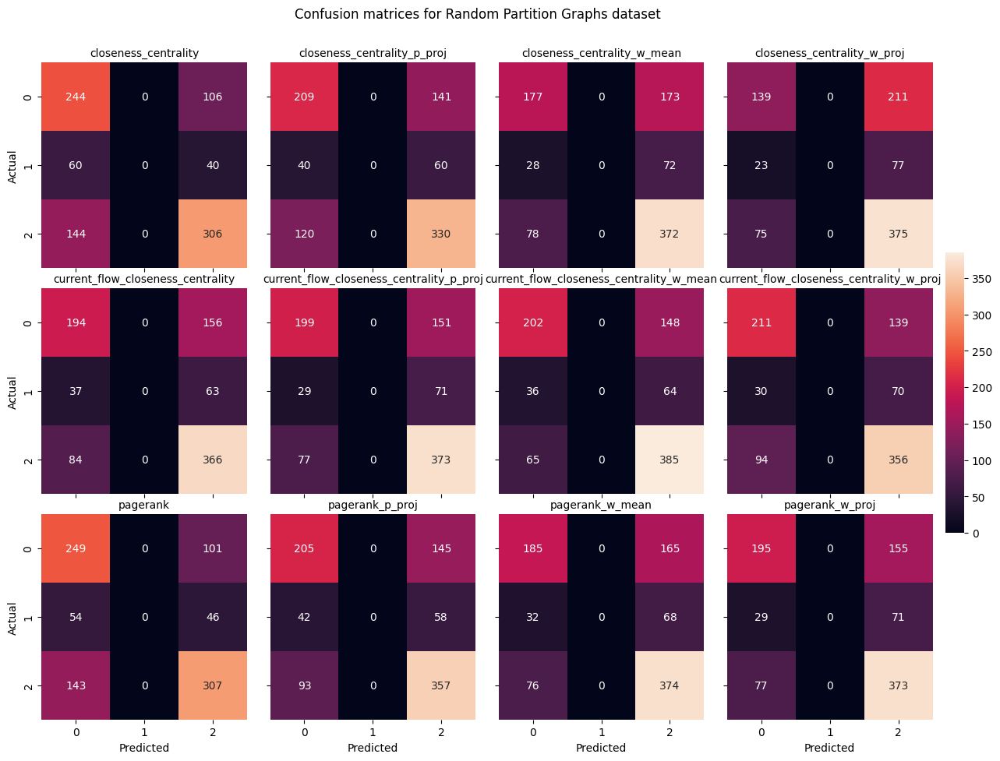

In [14]:
rpg_evaluator_best.plot_confusion_matrices_grid(
    plot_title="Confusion matrices for Random Partition Graphs dataset",
    cols_number_on_plot=4,
)

In [15]:
rpg_evaluator_best.plot_roc_curves(
    width=900,
    height=600,
)

In [16]:
rpg_evaluator_best.plot_precision_recall(width=800, height=600)

## Random Regular Graphs - synthetic dataset

In [17]:
rrg_results = pd.read_csv("../datasets/regular_graphs/results2.csv")

rrg_results["probability_prediction"] = (
    rrg_results[
        [
            "probability_prediction_0",
            "probability_prediction_1",
            "probability_prediction_2",
        ]
    ]
    .to_numpy()
    .tolist()
)

In [18]:
rrg_evaluator = MultiClassificationEvaluator(predictions=rrg_results)
rrg_eval_df = rrg_evaluator.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)
display(Markdown("All results"), rrg_eval_df)

# find top specification for each method
tmp = rrg_eval_df.merge(
    rrg_eval_df["method"]
    .str.rsplit("_", 1, expand=True)
    .rename(columns={0: "method_name", 1: "params"}),
    left_index=True,
    right_index=True,
)
idx = tmp.groupby(["method_name"])["macro_AUC"].transform(max) == tmp["macro_AUC"]
best = tmp.loc[idx][rrg_eval_df.columns]

display(Markdown("Top methods: "), list(best["method"]))

All results

,method,accuracy,macro_f1,macro_precision,macro_recall,macro_AUC
0,pagerank_w_mean_0.00,0.429474,0.214034,0.474876,0.341176,0.738886
1,pagerank_w_mean_0.25,0.711579,0.543853,0.835712,0.605135,0.937891
2,pagerank_w_mean_0.50,0.764211,0.665944,0.860656,0.677218,0.960535
3,pagerank_w_mean_0.75,0.989474,0.987163,0.990679,0.984127,1.000000
4,pagerank_w_mean_1.00,0.941053,0.948367,0.957862,0.945392,0.998440
5,pagerank_concat,0.993684,0.994566,0.994220,0.995000,1.000000
6,pagerank_p_proj_True,0.949474,0.953026,0.950428,0.958529,0.995883
7,pagerank_p_proj_False,1.000000,1.000000,1.000000,1.000000,1.000000
8,pagerank_w_proj_0.00,0.372632,0.372216,0.414790,0.376307,0.646190
9,pagerank_w_proj_0.25,0.789474,0.736922,0.742334,0.737563,0.916146


Top methods: 

['pagerank_w_mean_0.75',
 'pagerank_concat',
 'pagerank_p_proj_False',
 'pagerank_w_proj_1.00',
 'closeness_centrality_w_mean_1.00',
 'closeness_centrality_concat',
 'closeness_centrality_p_proj_True',
 'closeness_centrality_w_proj_0.75',
 'current_flow_closeness_centrality_w_mean_0.75',
 'current_flow_closeness_centrality_concat',
 'current_flow_closeness_centrality_p_proj_True',
 'current_flow_closeness_centrality_p_proj_False',
 'current_flow_closeness_centrality_w_proj_1.00']

In [19]:
# initialize the 2nd. evaluator to plot results for top methods only
rrg_results_best = rrg_results.loc[rrg_results["method"].isin(best["method"])]
rrg_results_best["method"] = rrg_results_best["method"].str.rsplit("_", 1, expand=True)[
    0
]

rrg_evaluator_best = MultiClassificationEvaluator(predictions=rrg_results_best)

In [20]:
rrg_evaluator_best.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)

,method,accuracy,macro_f1,macro_precision,macro_recall,macro_AUC
0,pagerank_w_mean,0.989474,0.987163,0.990679,0.984127,1.000000
1,pagerank,0.993684,0.994566,0.994220,0.995000,1.000000
2,pagerank_p_proj,1.000000,1.000000,1.000000,1.000000,1.000000
3,pagerank_w_proj,1.000000,1.000000,1.000000,1.000000,1.000000
4,closeness_centrality_w_mean,0.960000,0.965204,0.970172,0.963039,0.998510
5,closeness_centrality,0.964211,0.968867,0.973886,0.966667,1.000000
6,closeness_centrality_p_proj,0.983158,0.980105,0.976401,0.984902,1.000000
7,closeness_centrality_w_proj,1.000000,1.000000,1.000000,1.000000,1.000000
8,current_flow_closeness_centrality_w_mean,0.932632,0.928121,0.948648,0.915406,0.999916
9,current_flow_closeness_centrality,0.970526,0.974413,0.978193,0.972549,0.999377


In [21]:
stats = rrg_evaluator_best.calculate_classification_metrics(
    if_return_melted_not_pivoted=False
)

display("Mean:", stats.mean())

display("Standard deviation:", stats.std())

'Mean:'

accuracy           0.981053
macro_f1           0.981635
macro_precision    0.984558
macro_recall       0.980198
macro_AUC          0.999736
dtype: float64

'Standard deviation:'

accuracy           0.020841
macro_f1           0.020931
macro_precision    0.015713
macro_recall       0.024310
macro_AUC          0.000497
dtype: float64

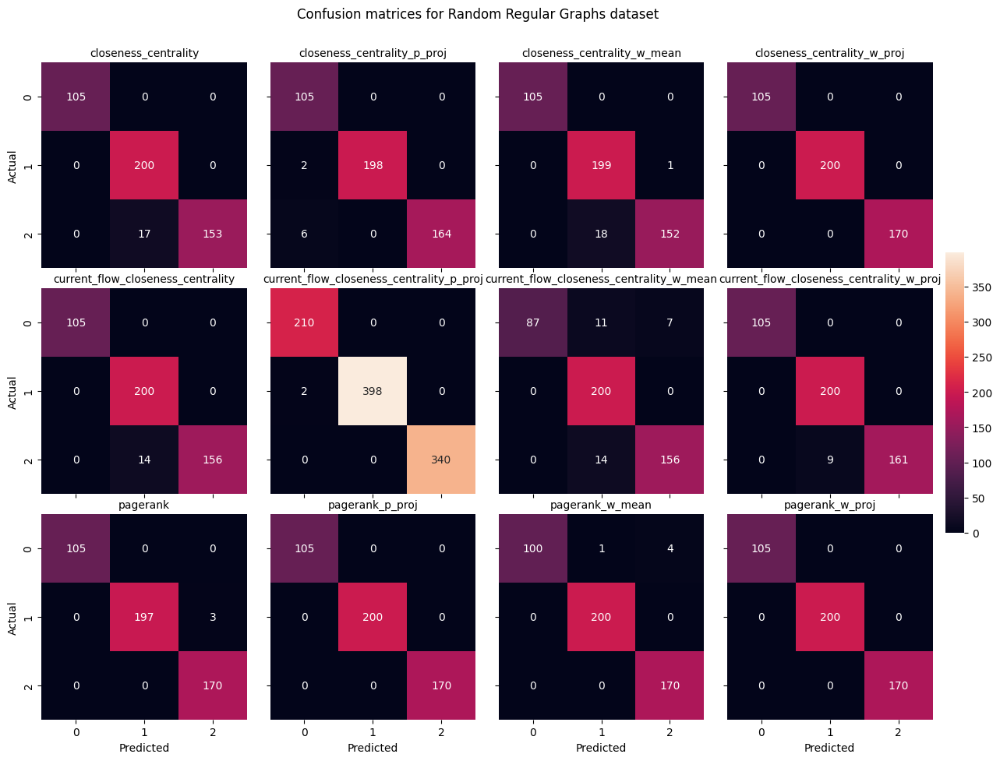

In [22]:
rrg_evaluator_best.plot_confusion_matrices_grid(
    plot_title="Confusion matrices for Random Regular Graphs dataset",
    cols_number_on_plot=4,
)

In [23]:
rrg_evaluator_best.plot_roc_curves(
    width=900,
    height=600,
)

In [24]:
rrg_evaluator_best.plot_precision_recall(width=800, height=600)